In [1]:
import logging
from time import time
from os import listdir
from numpy.random import RandomState
import matplotlib.pyplot as plt
from cmocean import cm
import numpy as np
from sklearn.datasets import fetch_olivetti_faces
from sklearn.cluster import MiniBatchKMeans
from sklearn import decomposition
import cv2
import matplotlib.pylab as pylab

%matplotlib inline

# Read Images

In [2]:
flag = True
# directory = '/home/nilavro/data/f03/2017-12-08/1512681434856'
# directory = '/home/nilavro/data/f03/2017-12-15/1513304232411'
# directory = '/home/nilavro/data/f03/2017-12-17/1513361832444'
# directory = '/home/nilavro/data/f03/2017-12-18/1513549032246'

directory = '/home/nilavro/data/f03/2017-12-19/1513664059443'
# directory = '/home/nilavro/data/f03/2017-12-19/1513685832345'


# directory = '/home/nilavro/data/Nilavra_z1/2017-12-20/1513736748855'

In [3]:

startX = 0
stopX = 550
startY = 1500
stopY = 3000
for dir in sorted(listdir(directory)):
    print(dir)
    temps  = np.loadtxt(directory +  '/' + dir  +'/stitched/stitchedtemps_0.txt', dtype = np.float64, delimiter=',')
    temps = temps[startX:stopX,startY:stopY]
    
    # temps = cv2.resize(temps,None,fx=0.09, fy=0.03, interpolation = cv2.INTER_CUBIC)
    if flag:
        flag = False
        (row,col) = temps.shape
        
        Temps = np.empty((0,row*col), np.float64)
    Temps = np.vstack( (Temps, np.reshape(temps,(row*col))))

1513664403535
1513664703540
1513665003225
1513665303156
1513665602674
1513665902942
1513666203082
1513666503143
1513666802647
1513667103130
1513667402862
1513667703203
1513668002571
1513668303474
1513668603438
1513668902797
1513669203225
1513669503520
1513669803448
1513670102999
1513670402908
1513670702668
1513671002800
1513671302641
1513671603129
1513671903213
1513672203065
1513672502640
1513672803502
1513673103342
1513673403353
1513673703417
1513674002800
1513674303436
1513674602578
1513674903131
1513675203327
1513675503477
1513675802807
1513676102872
1513676402559
1513676703017
1513677003417
1513677302996
1513677602663
1513677903487
1513678202690
1513678503060
1513678803014
1513679102885
1513679402810
1513679703362
1513680003520
1513680303011
1513680603076
1513680903240
1513681202678
1513681502695
1513681803357
1513682103466
1513682403514
1513682704025
1513683003522
1513683302787
1513683602618
1513683903458
1513684202601
1513684503381
1513684803394
1513685102912
1513685403187
151368

In [ ]:
numbers = len(Temps)

for i in range(0,len(Temps)):
    image = Temps[i] 
    
    # image[image < 70] = 0
    
    plt.imshow(image.reshape(row,col), cmap = cm.thermal, vmin = 65, vmax = 85)
    plt.colorbar()
    plt.show()

1513664403535 0


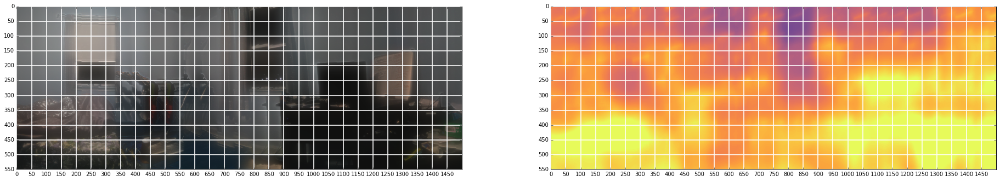

1513664703540 1


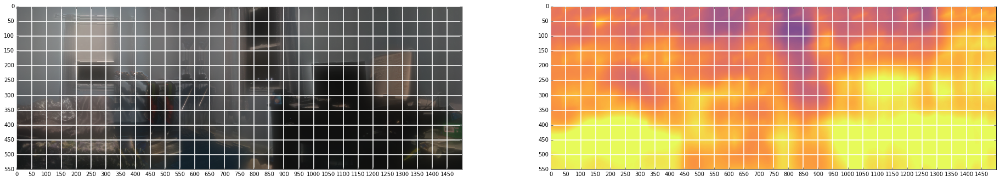

1513665003225 2


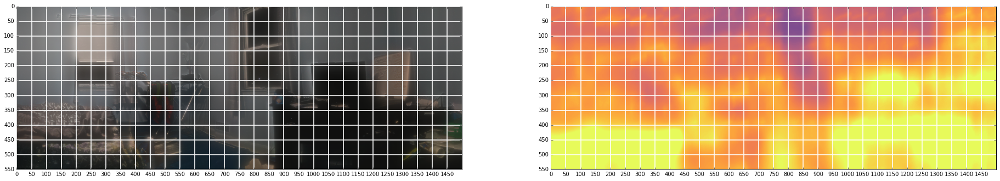

1513665303156 3


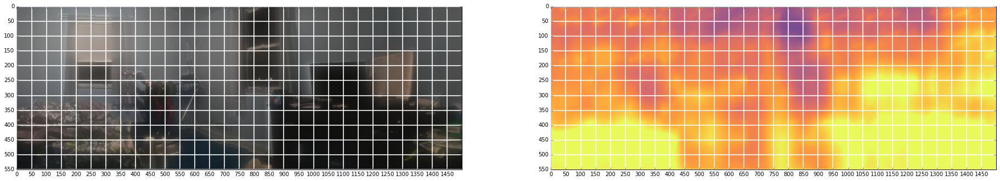

1513665602674 4


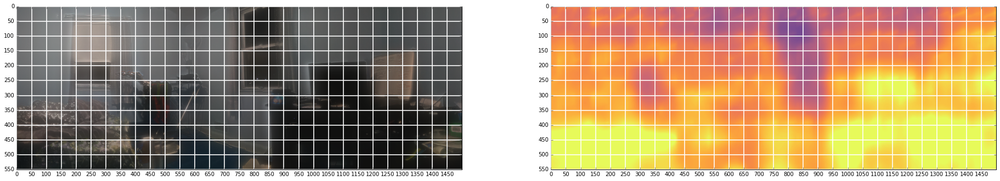

1513665902942 5


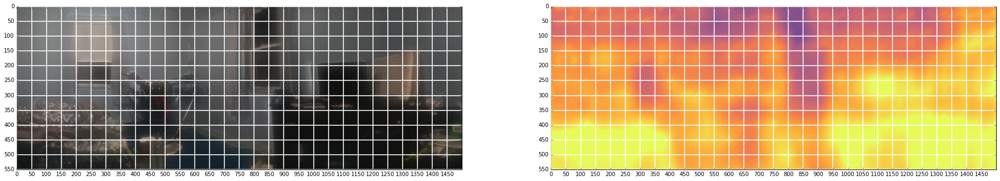

1513666203082 6


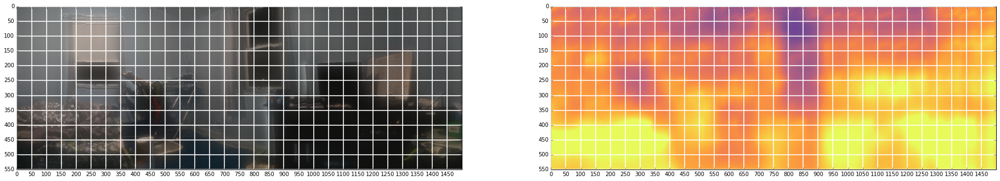

1513666503143 7


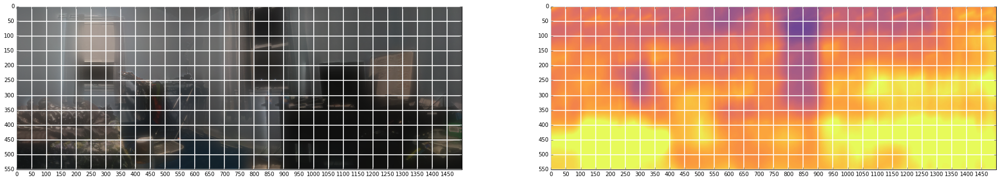

1513666802647 8


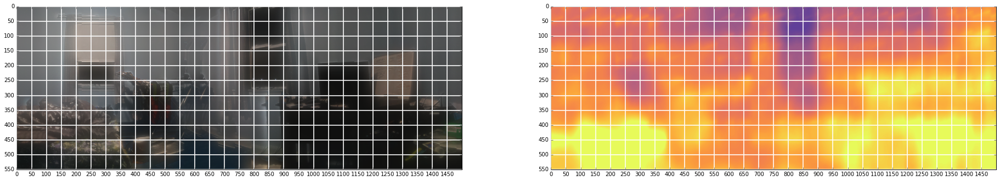

1513667103130 9


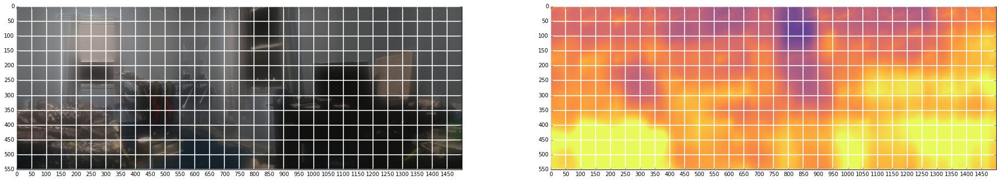

1513667402862 10


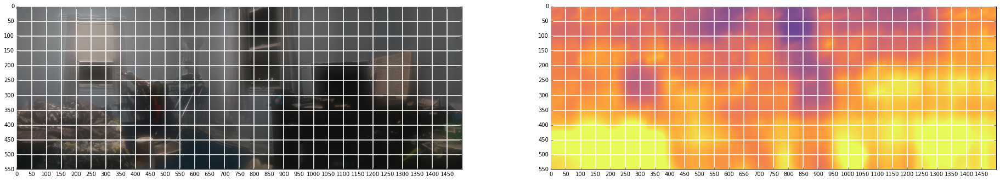

1513667703203 11


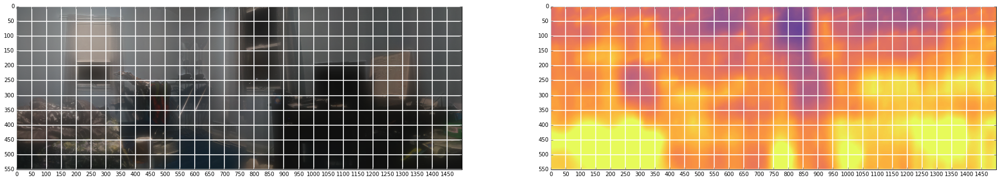

1513668002571 12


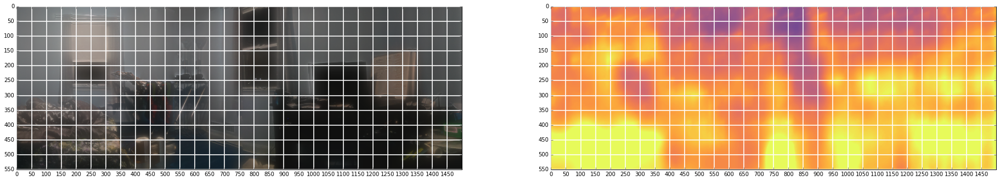

1513668303474 13


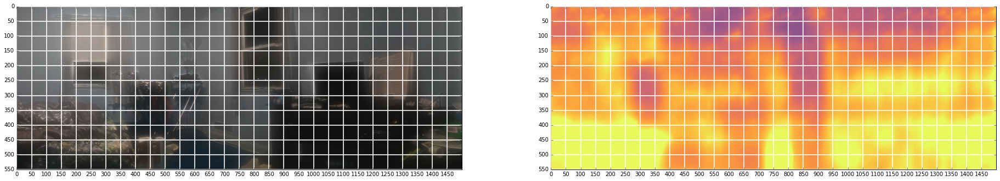

1513668603438 14


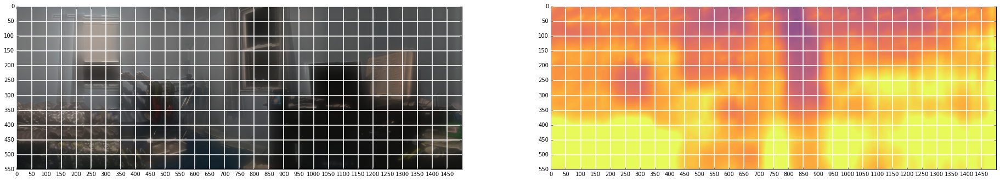

1513668902797 15


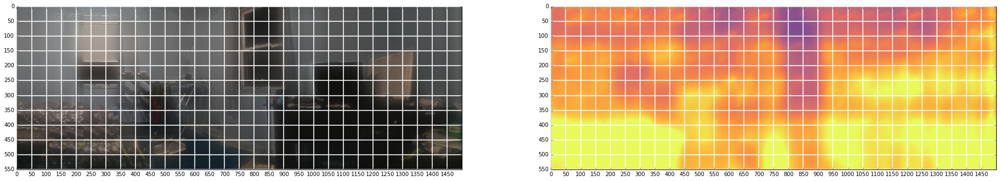

1513669203225 16


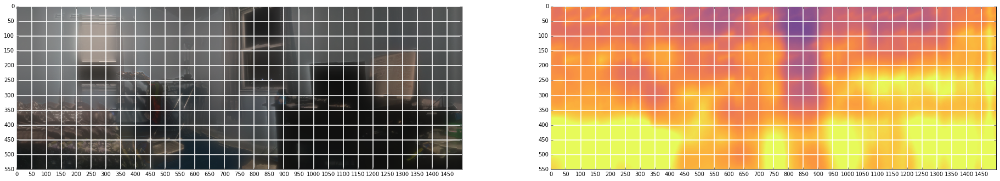

1513669503520 17


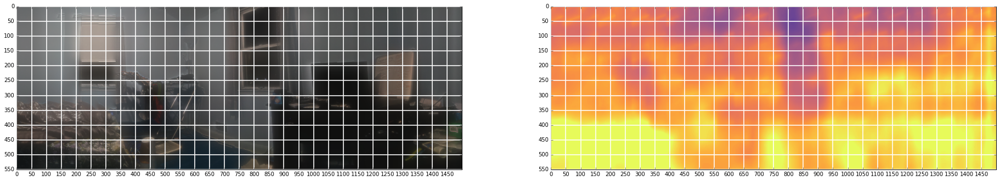

1513669803448 18


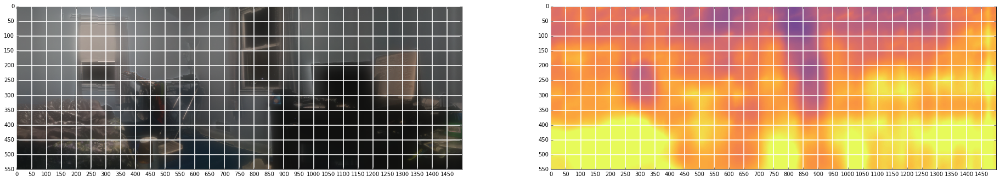

1513670102999 19


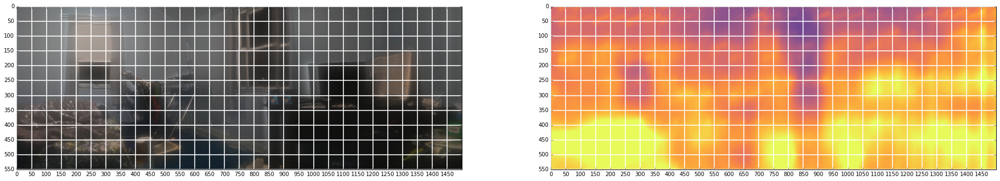

1513670402908 20


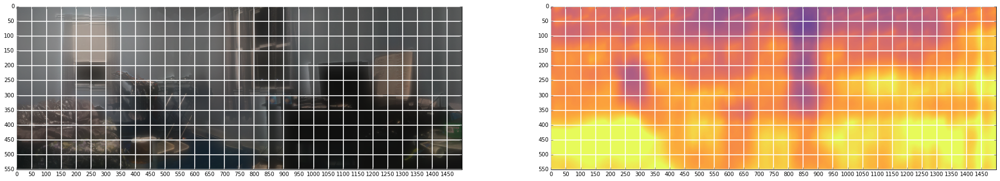

1513670702668 21


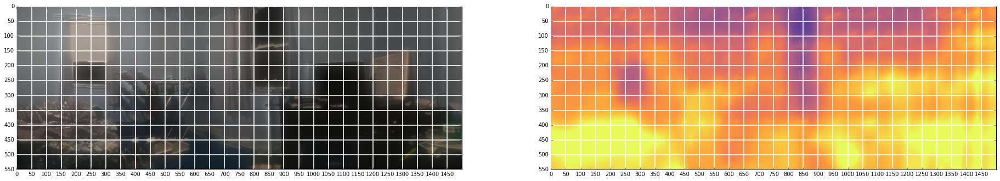

1513671002800 22


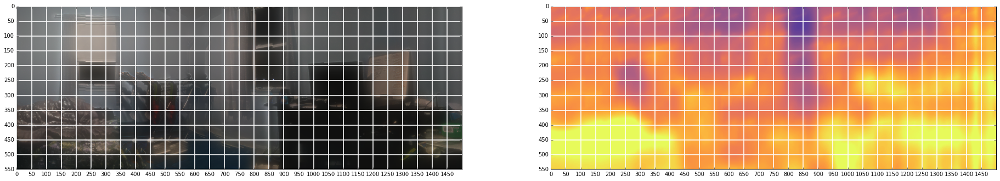

1513671302641 23


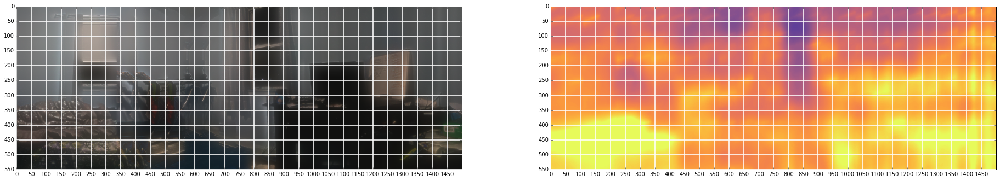

1513671603129 24


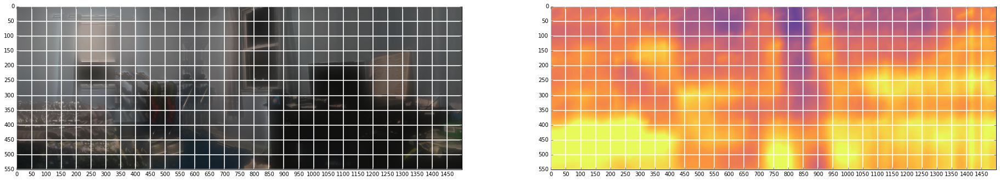

1513671903213 25


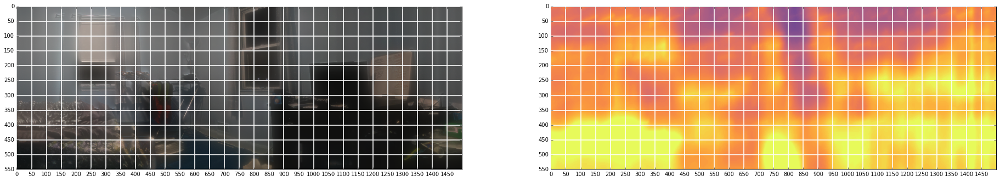

1513672203065 26


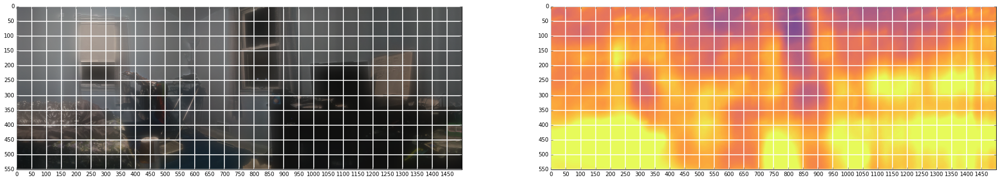

1513672502640 27


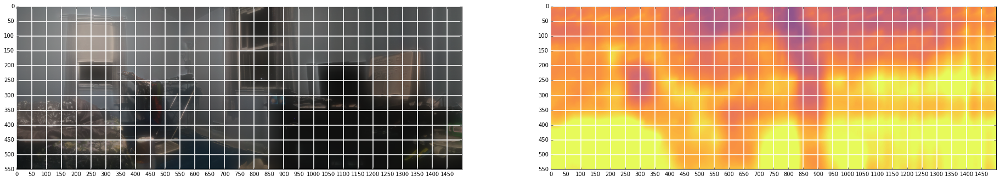

1513672803502 28


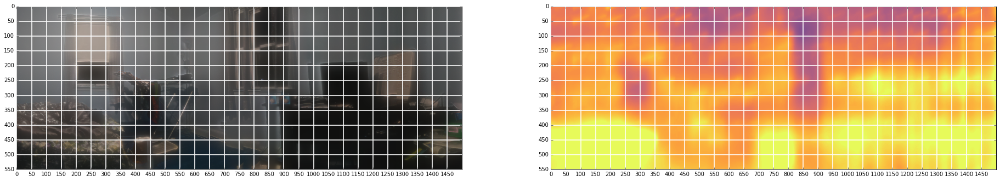

1513673103342 29


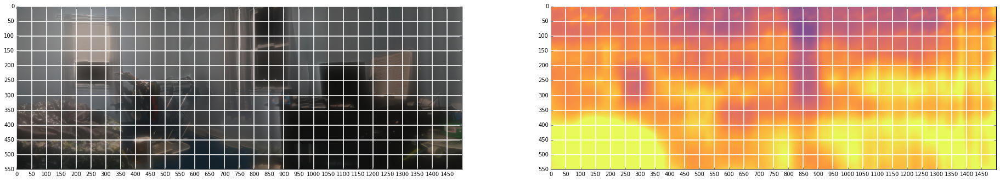

1513673403353 30


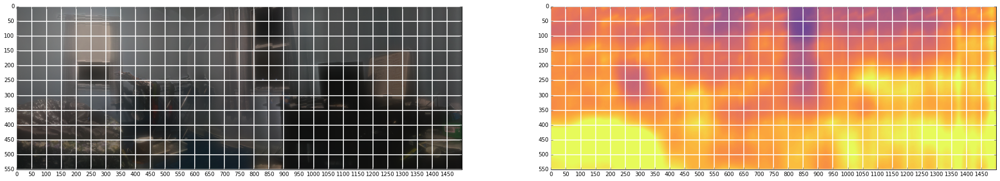

1513673703417 31


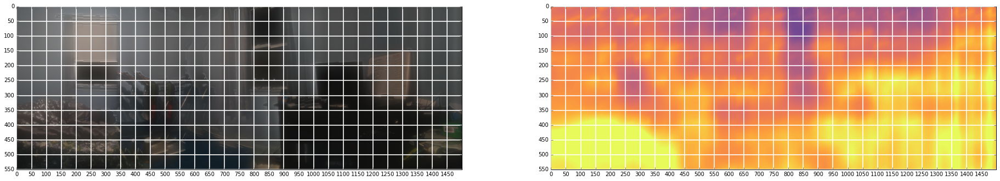

1513674002800 32


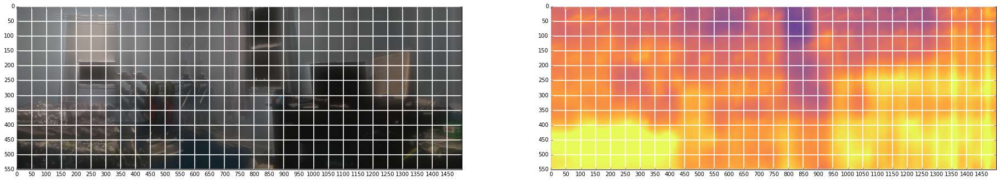

1513674303436 33


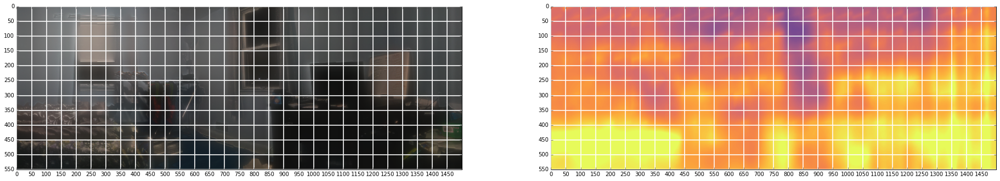

1513674602578 34


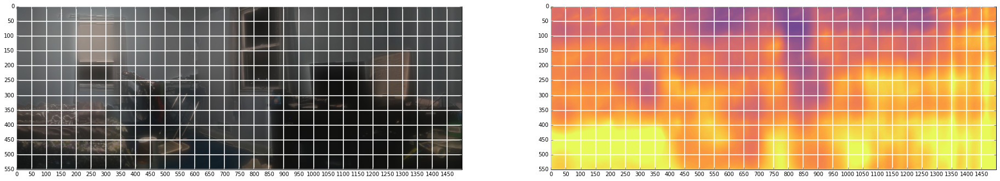

1513674903131 35


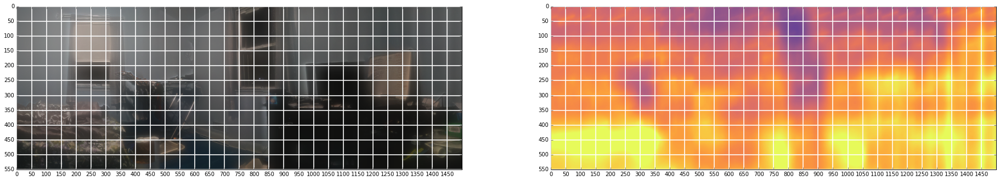

1513675203327 36


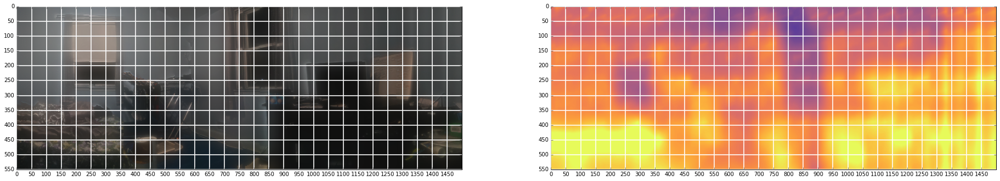

1513675503477 37


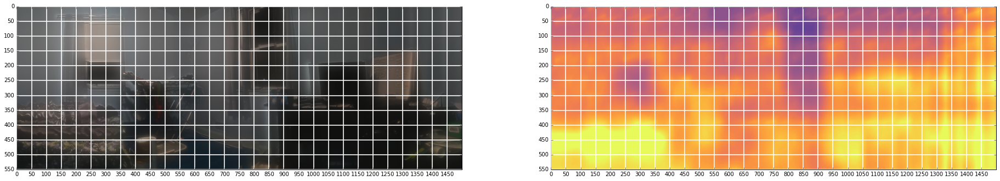

1513675802807 38


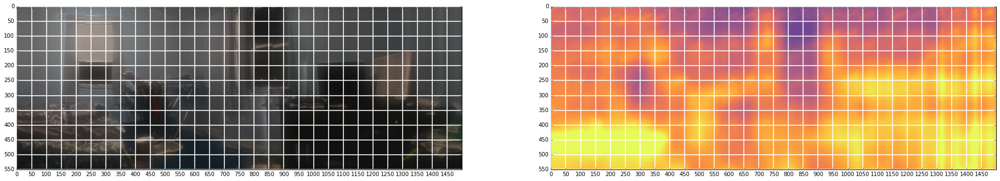

1513676102872 39


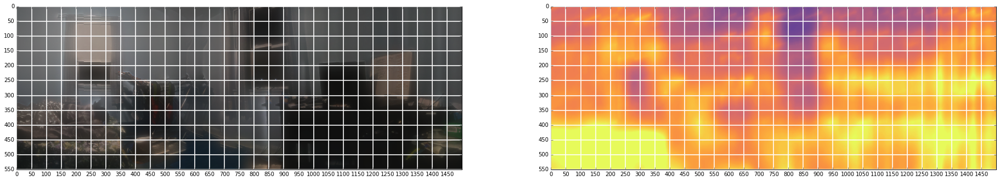

1513676402559 40


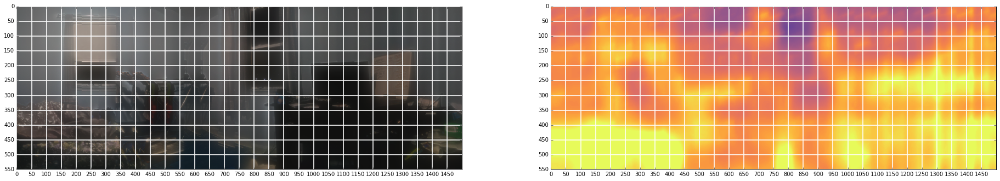

1513676703017 41


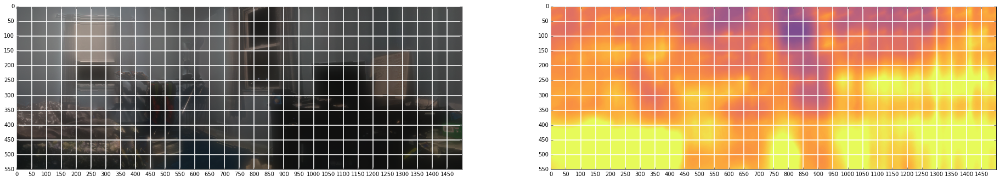

1513677003417 42


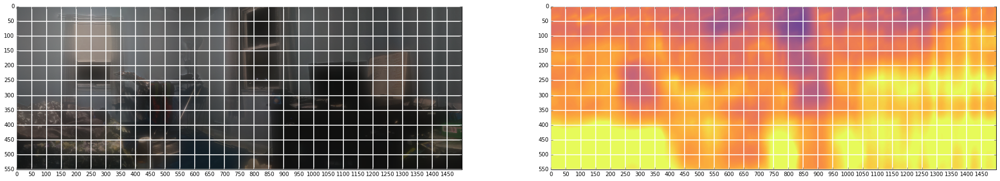

1513677302996 43


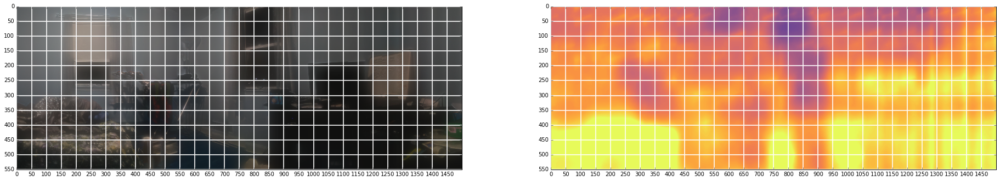

1513677602663 44


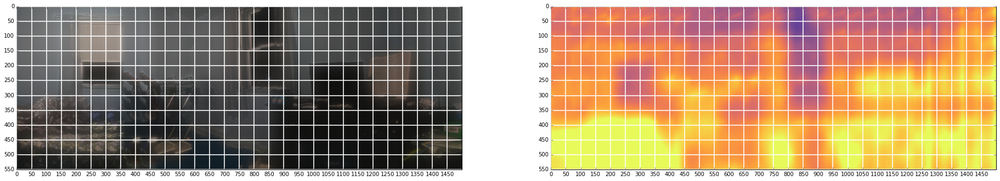

1513677903487 45


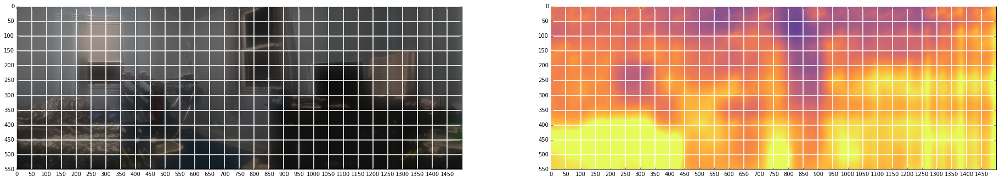

1513678202690 46


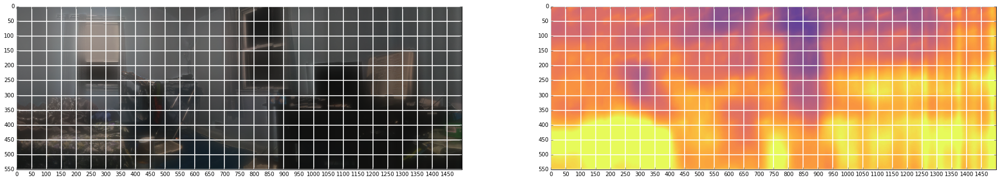

1513678503060 47


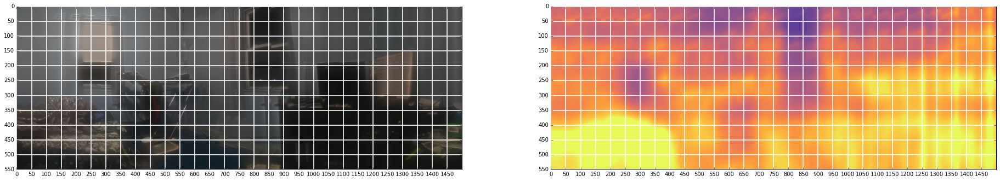

1513678803014 48


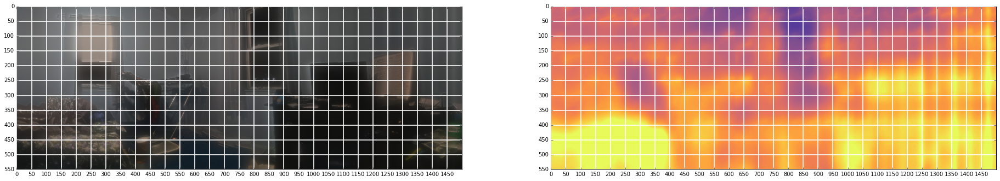

1513679102885 49


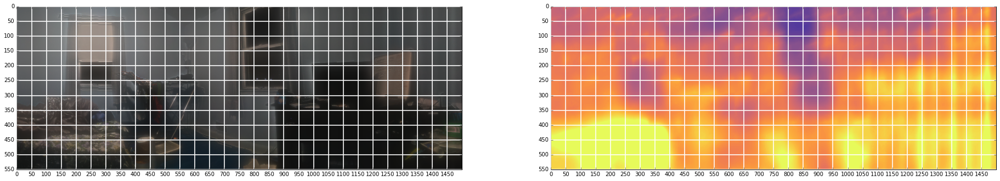

1513679402810 50


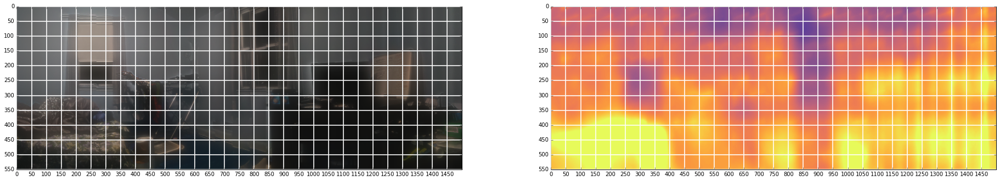

1513679703362 51


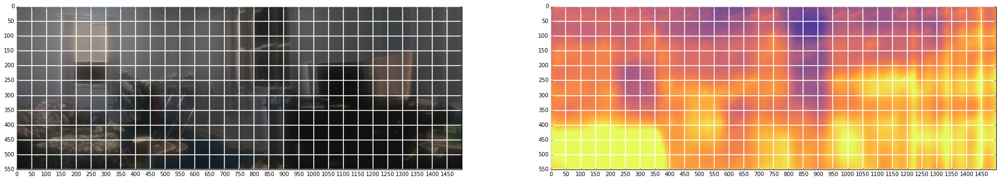

1513680003520 52


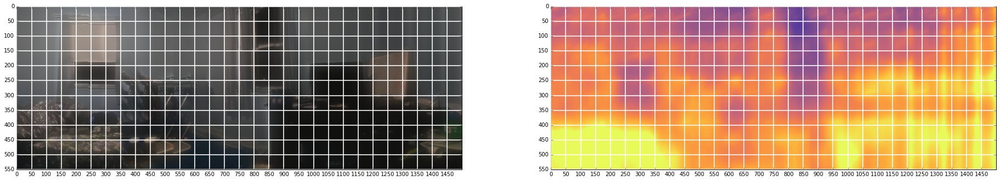

1513680303011 53


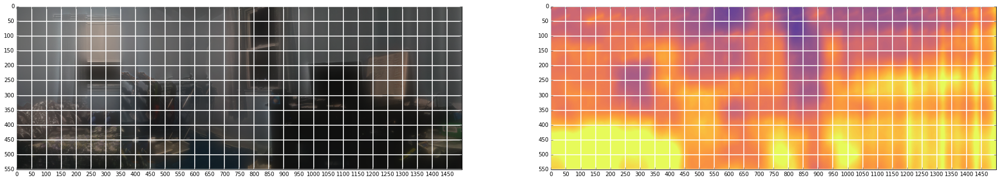

1513680603076 54


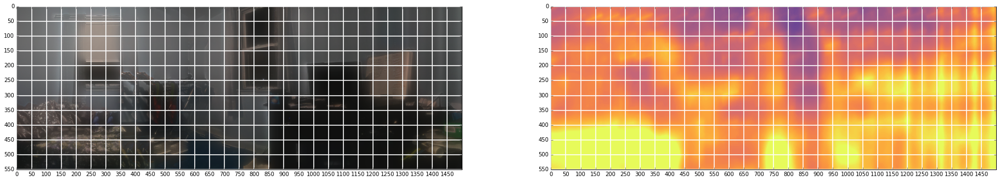

1513680903240 55


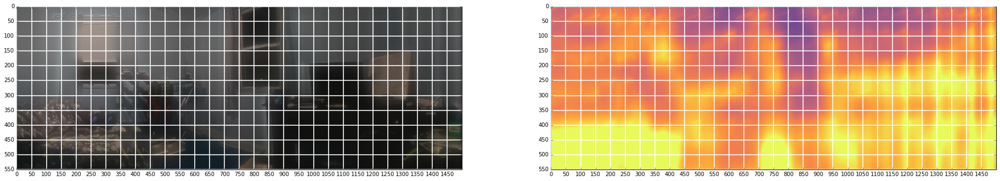

1513681202678 56


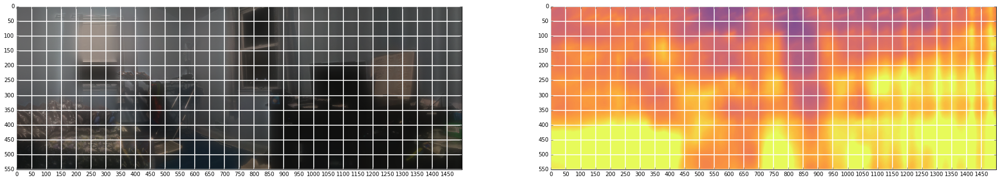

1513681502695 57


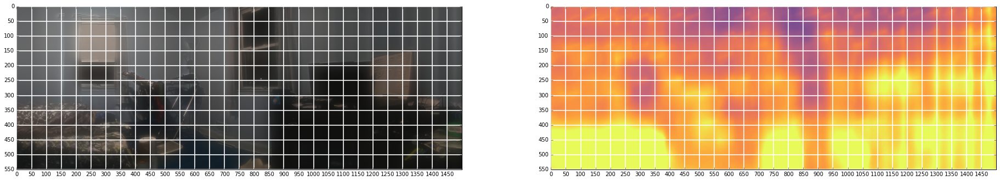

1513681803357 58


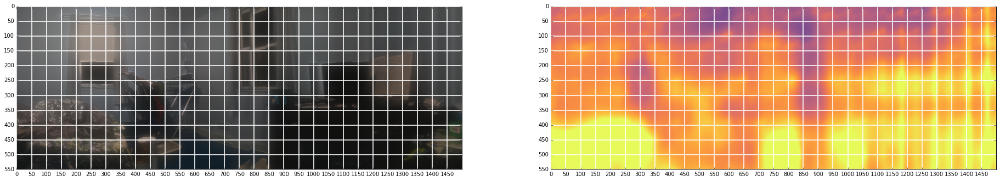

1513682103466 59


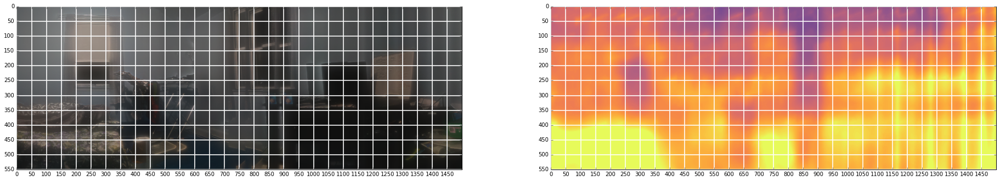

1513682403514 60


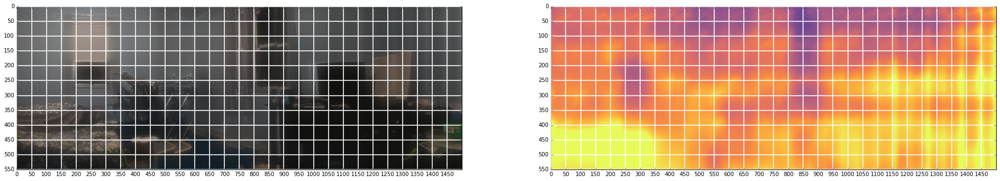

1513682704025 61


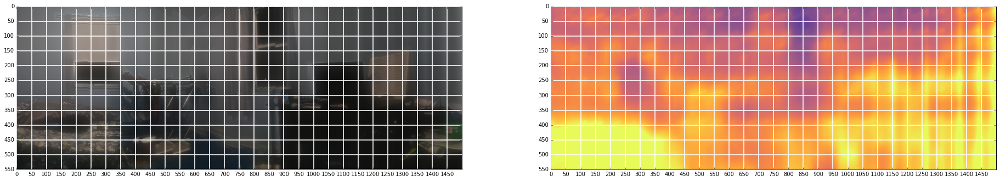

1513683003522 62


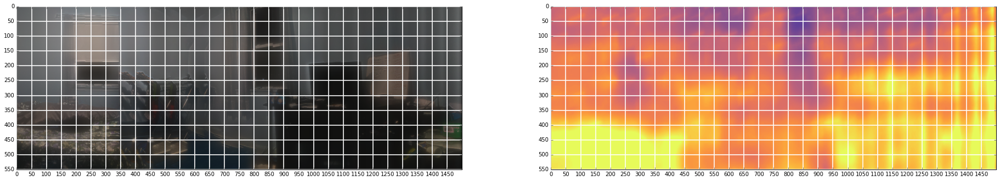

1513683302787 63


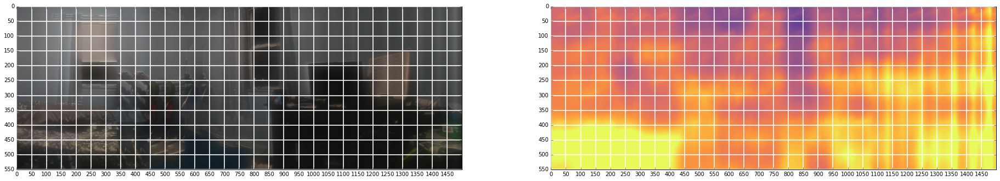

1513683602618 64


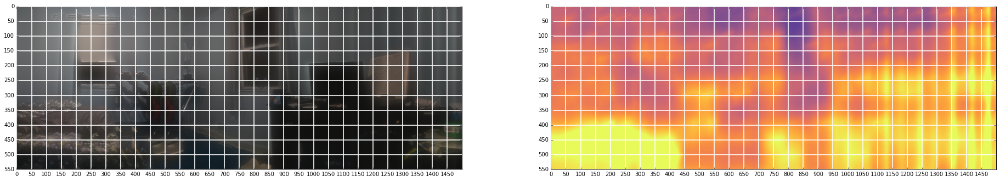

1513683903458 65


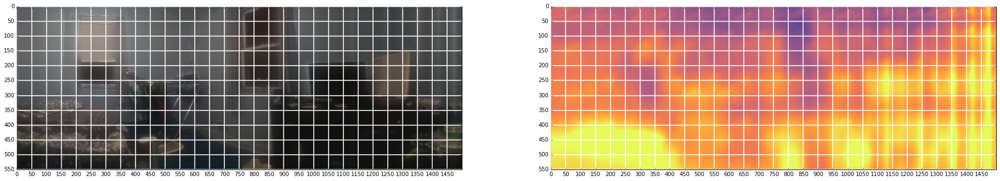

1513684202601 66


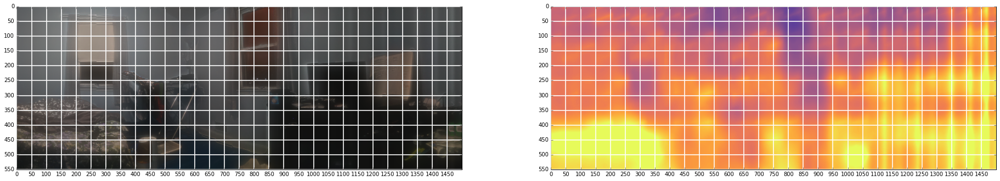

1513684503381 67


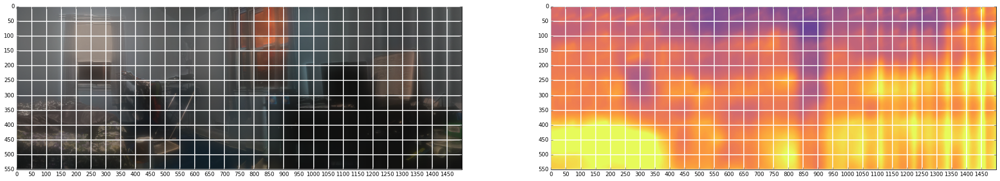

1513684803394 68


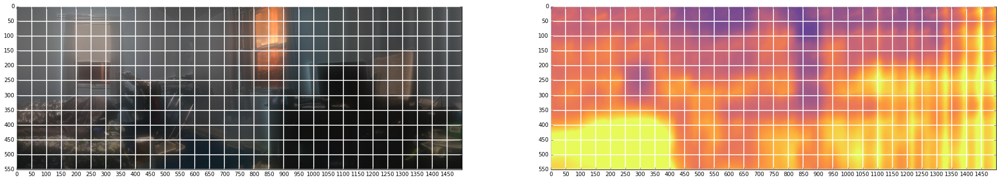

1513685102912 69


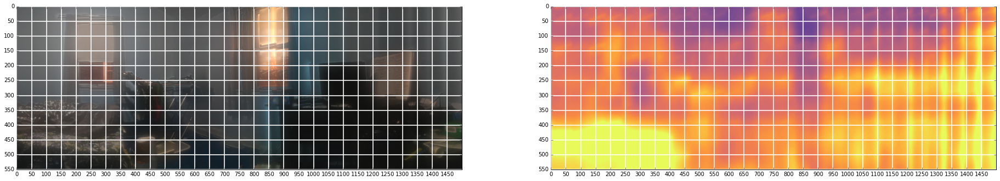

1513685403187 70


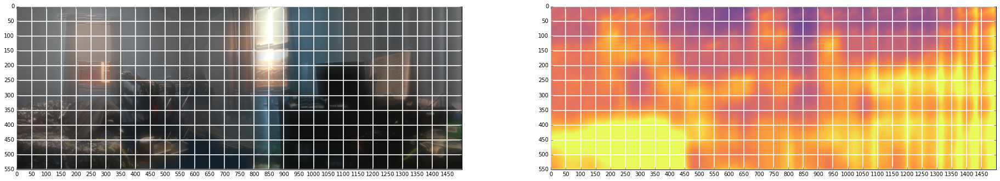

1513685702928 71


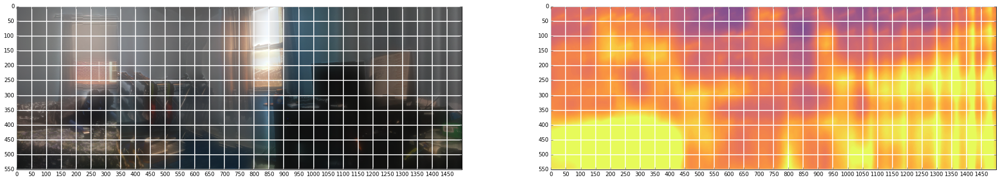

1513686003201 72


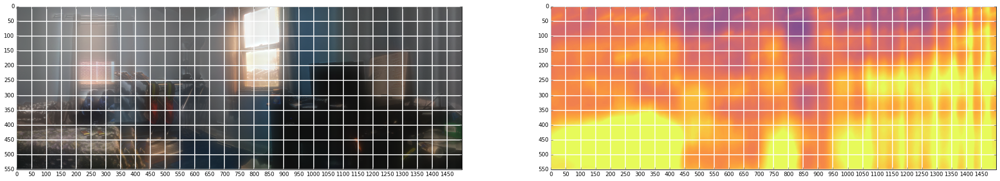

1513686302611 73


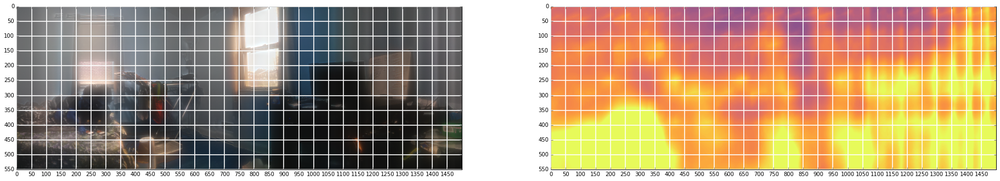

1513686602698 74


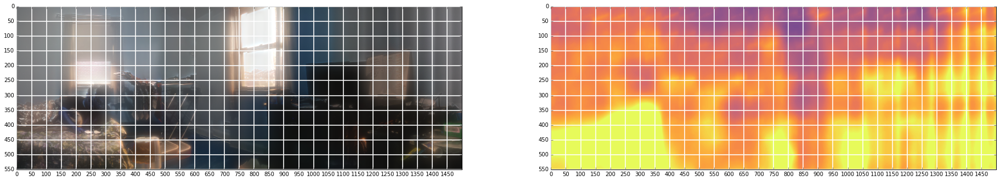

1513686903394 75


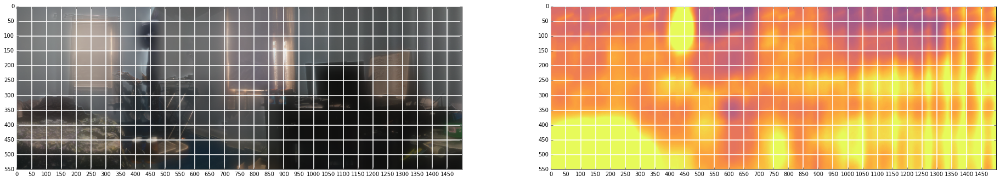

In [4]:
pylab.rcParams['figure.figsize'] = 32, 24 
count = 0
for dir in sorted(listdir(directory)):
    print(dir, count)
    pic2  = cv2.imread(directory + '/' + dir  + '/stitched/stitchedVisual_0.png')
    # temp  = cv2.imread(directory + '/' + dir  + '/stitched/stitchedtemps_0.png')

    temps  = np.loadtxt(directory +  '/' + dir  +'/stitched/stitchedtemps_0.txt', dtype = np.float64, delimiter=',')
    f, axarr = plt.subplots(1,2) 
    axarr[0].imshow(pic2[startX:stopX,startY:stopY] )
    axarr[1].imshow(temps[startX:stopX,startY:stopY] , cmap=cm.thermal ,vmin = 60, vmax = 90)
    # axarr[2].imshow(temp)
   
    count = count + 1
    major_ticks = np.arange(0, 1500, 50)                                              
    minor_ticks = np.arange(0, 600, 50)                                               

    # ax.set_xticks(major_ticks)                                                       
    # ax.set_xticks(minor_ticks, minor=True)                                           
    # ax.set_yticks(minor_ticks)                                                       
    # ax.set_yticks(minor_ticks, minor=True)                                               

    axarr[0].set_xticks(major_ticks)                                                       

    axarr[0].set_yticks(minor_ticks)                                                       


    axarr[0].grid(color='w', linestyle='-', linewidth=2, alpha= 50)    
    axarr[1].set_xticks(major_ticks)                                                       

    axarr[1].set_yticks(minor_ticks)                                                       


    axarr[1].grid(color='w', linestyle='-', linewidth=2, alpha= 50)     
    plt.show() 

In [5]:
from __future__ import print_function

from time import time
import logging
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import fetch_lfw_people
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.decomposition import PCA, FastICA
from sklearn.svm import SVC


print(__doc__)

# Display progress logs on stdout
logging.basicConfig(level=logging.INFO, format='%(asctime)s %(message)s')

Automatically created module for IPython interactive environment


In [6]:
"""
for i in range(0,n_components):
    plt.imshow(eigenfaces[i,:,:], cmap='gray')
    plt.show()
"""

"\nfor i in range(0,n_components):\n    plt.imshow(eigenfaces[i,:,:], cmap='gray')\n    plt.show()\n"

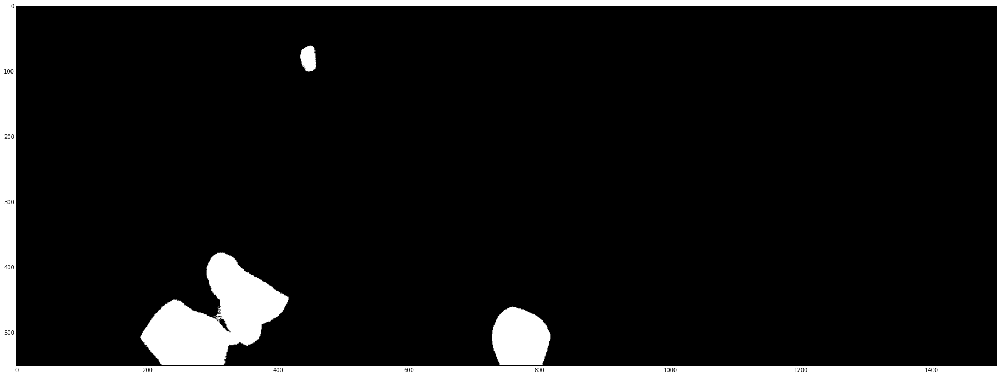

In [10]:
from copy import deepcopy
import matplotlib
n_components = 4

estimator = PCA(n_components = n_components, whiten=True).fit(  Temps  ) # Reconstruct signals
S_ = estimator.components_


merged =  np.abs(deepcopy(S_[0,:].reshape(row, col)))

for i in range(1,n_components):
    merged = merged + np.abs(deepcopy(S_[i,:].reshape(row, col)))
    

my_cm = matplotlib.cm.get_cmap('gray')

normed_data = (merged - np.min(merged)) / (np.max(merged) - np.min(merged))
mapped_data = my_cm(normed_data)

mapped_data = my_cm(normed_data, bytes=True)
mapped_data = mapped_data[:,:,0]

ret3,th3 = cv2.threshold(mapped_data,127,255,cv2.THRESH_BINARY)
plt.imshow(th3 , cmap = 'gray')

# Connected Component Analysis

In [11]:
from skimage import measure
from imutils import contours

import imutils

# perform a series of erosions and dilations to remove
# any small blobs of noise from the thresholded image

image = Temps[i]
thresh = cv2.erode(th3, None, iterations=2)
thresh = cv2.dilate(thresh, None, iterations=4)

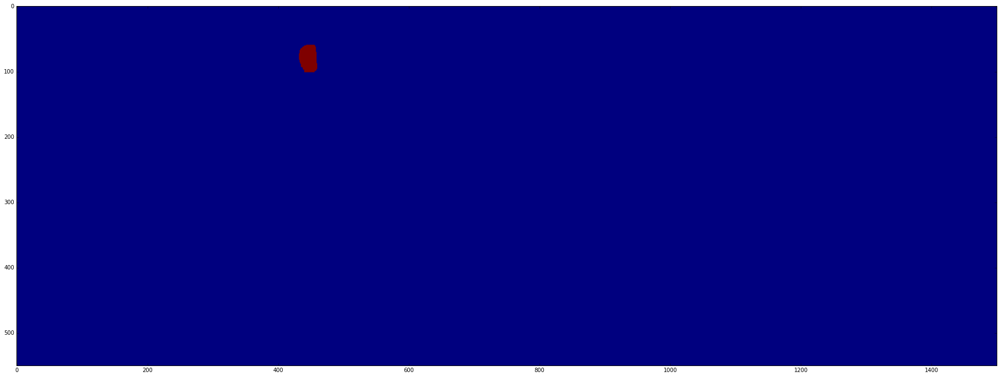

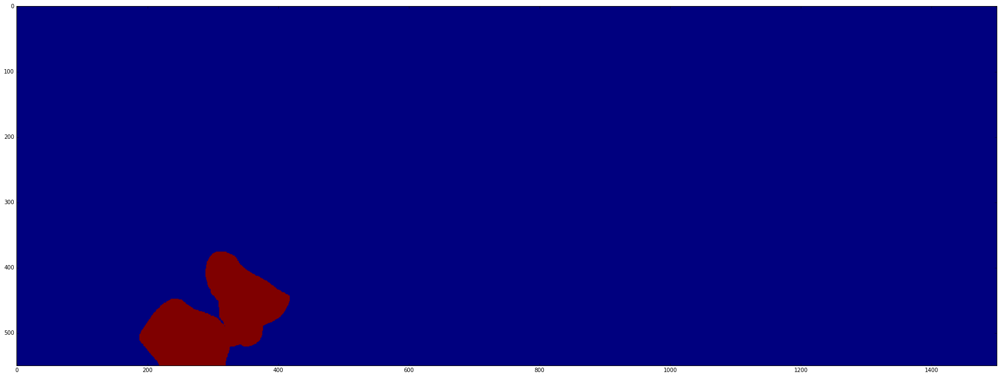

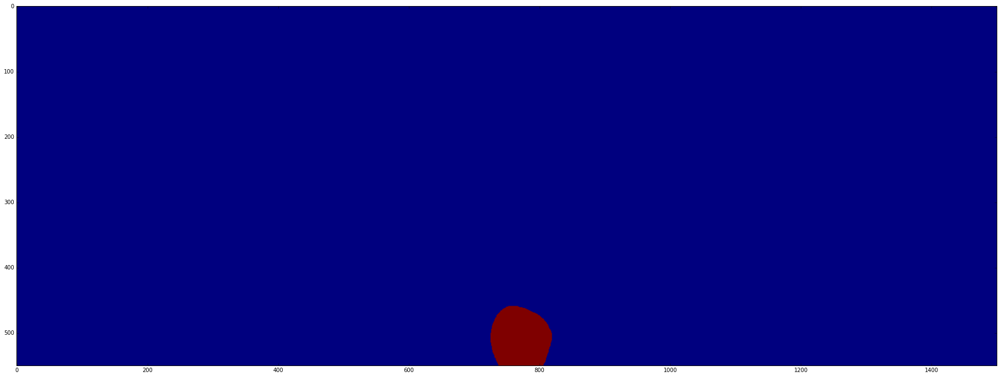

In [12]:


# perform a connected component analysis on the thresholded
# image, then initialize a mask to store only the "large"
# components
labels = measure.label(thresh, neighbors=8, background=0)
mask = np.zeros(thresh.shape, dtype="uint8")

# loop over the unique components

Label_Mask =   np.empty((0,row*col), np.float64)
count = 0
for label in np.unique(labels):
    # if this is the background label, ignore it
    if label == 0:
        continue

    # otherwise, construct the label mask and count the
    # number of pixels 
    labelMask = np.zeros(thresh.shape, dtype="uint8")
    labelMask[labels == label] = 255
    numPixels = cv2.countNonZero(labelMask)

    # if the number of pixels in the component is sufficiently
    # large, then add it to our mask of "large blobs"
    if numPixels > 300:
        mask = cv2.add(mask, labelMask)
    
    Label_Mask =  np.vstack( (Label_Mask, np.reshape(labelMask,(row*col))))
    plt.imshow(Label_Mask[count].reshape(row,col))
    plt.show()
    
    count = count + 1

In [13]:
Label_Mask[1].shape

(825000,)

In [14]:
np.max(np.multiply(image,Label_Mask[1]/255).reshape(row,col))

78.658032724113809

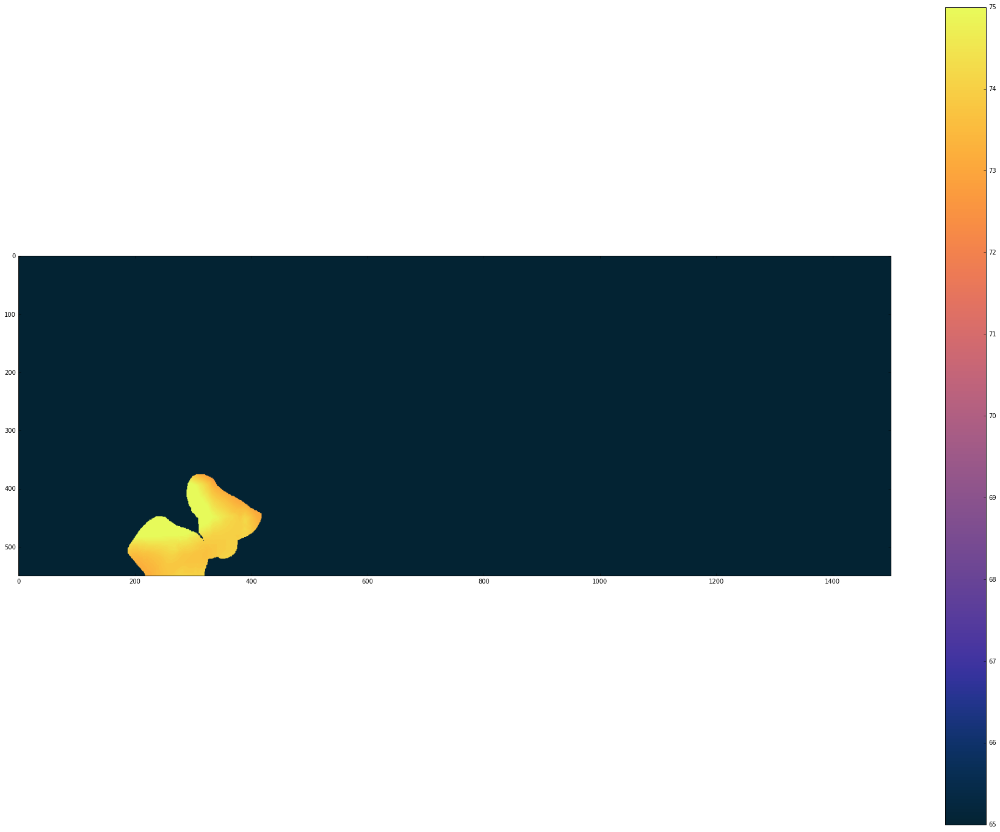

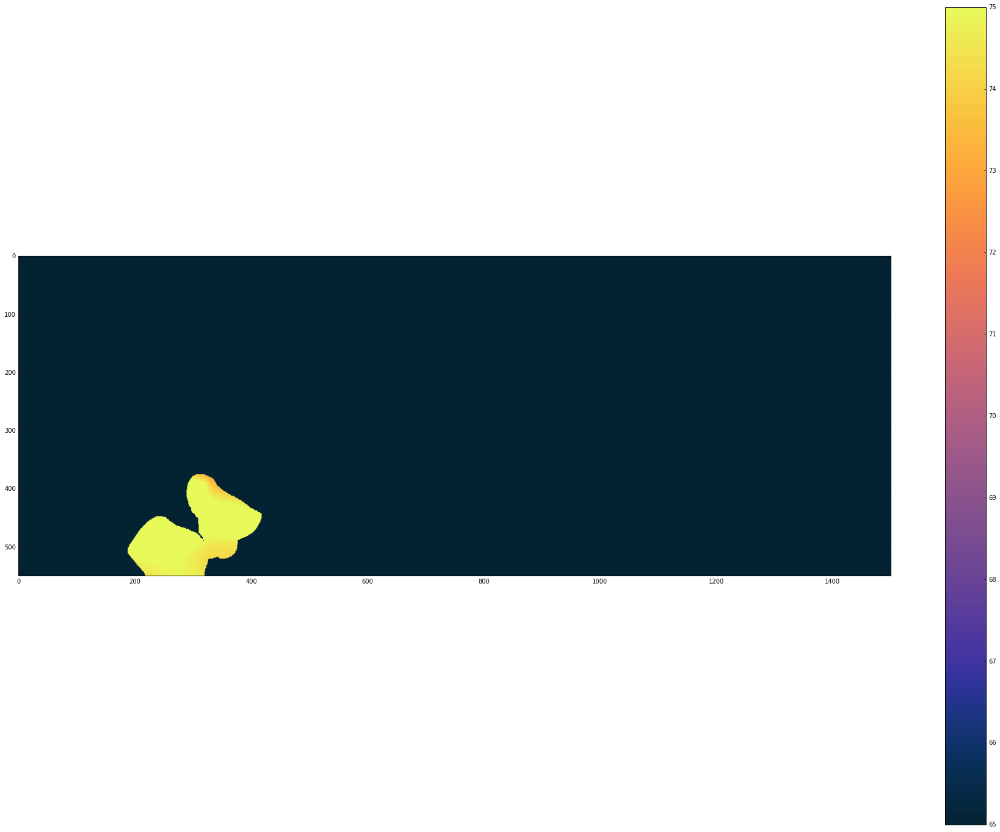

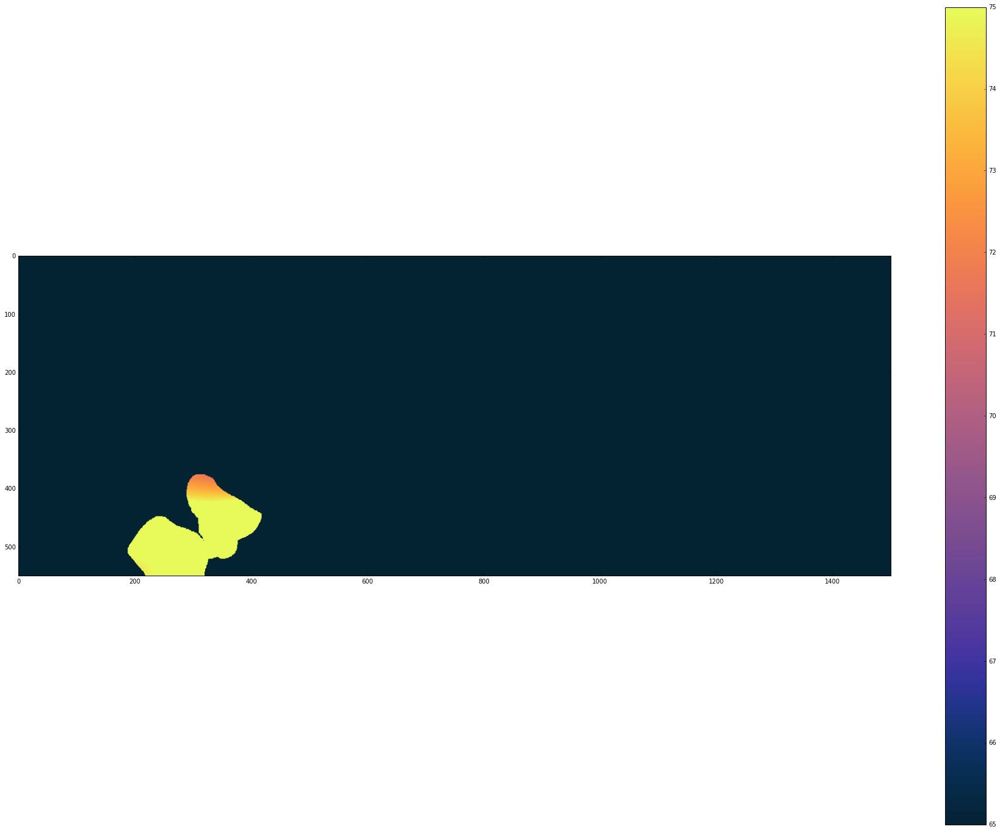

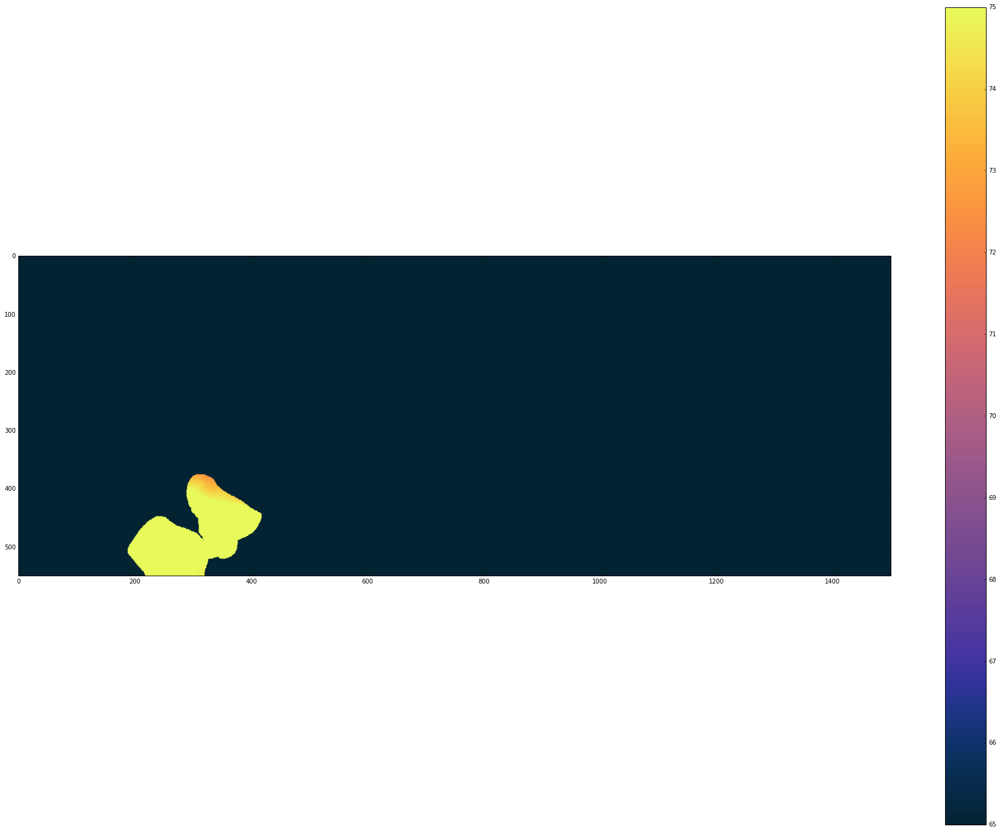

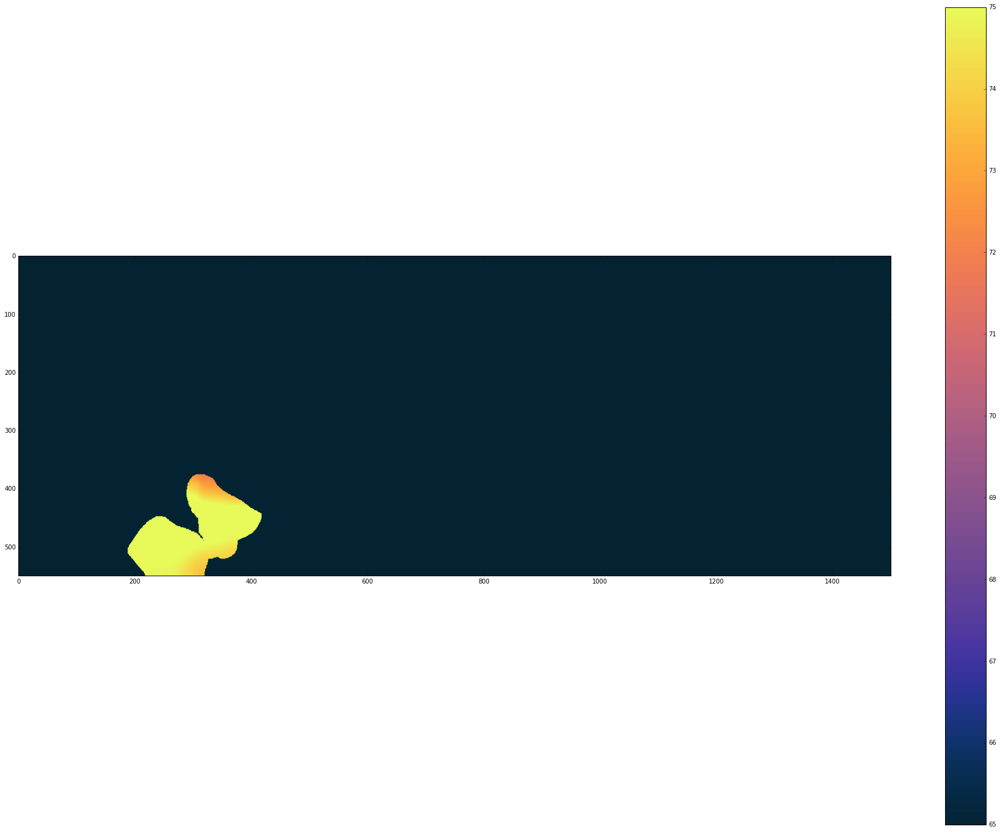

...

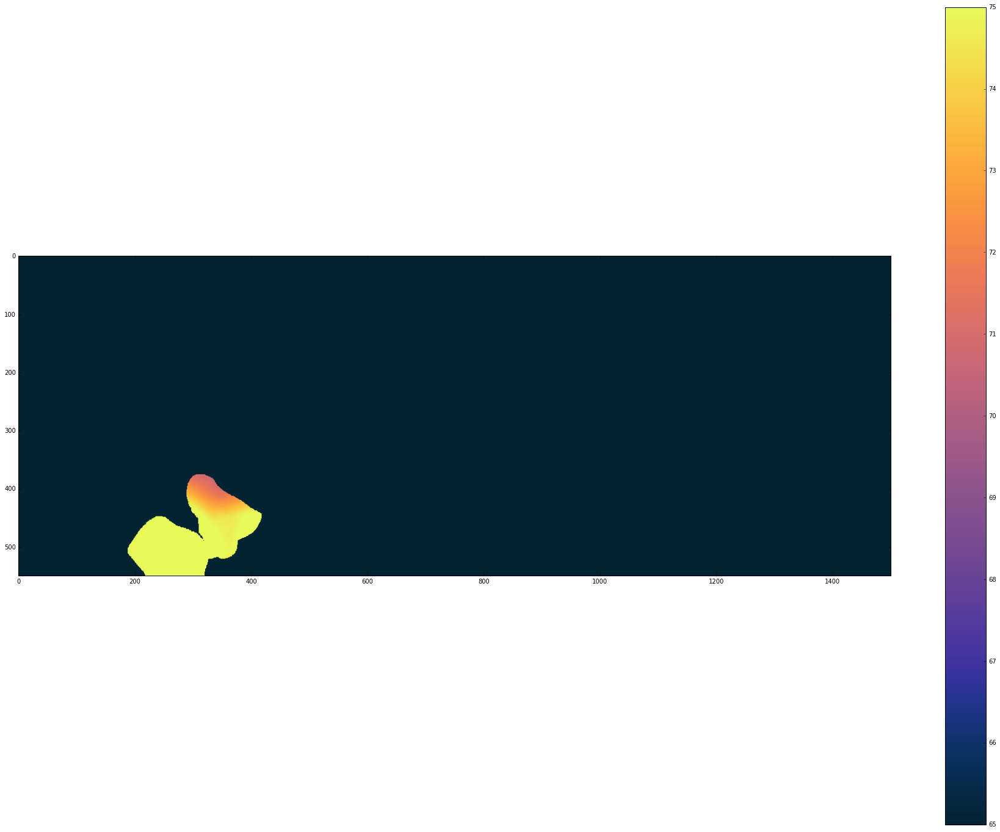

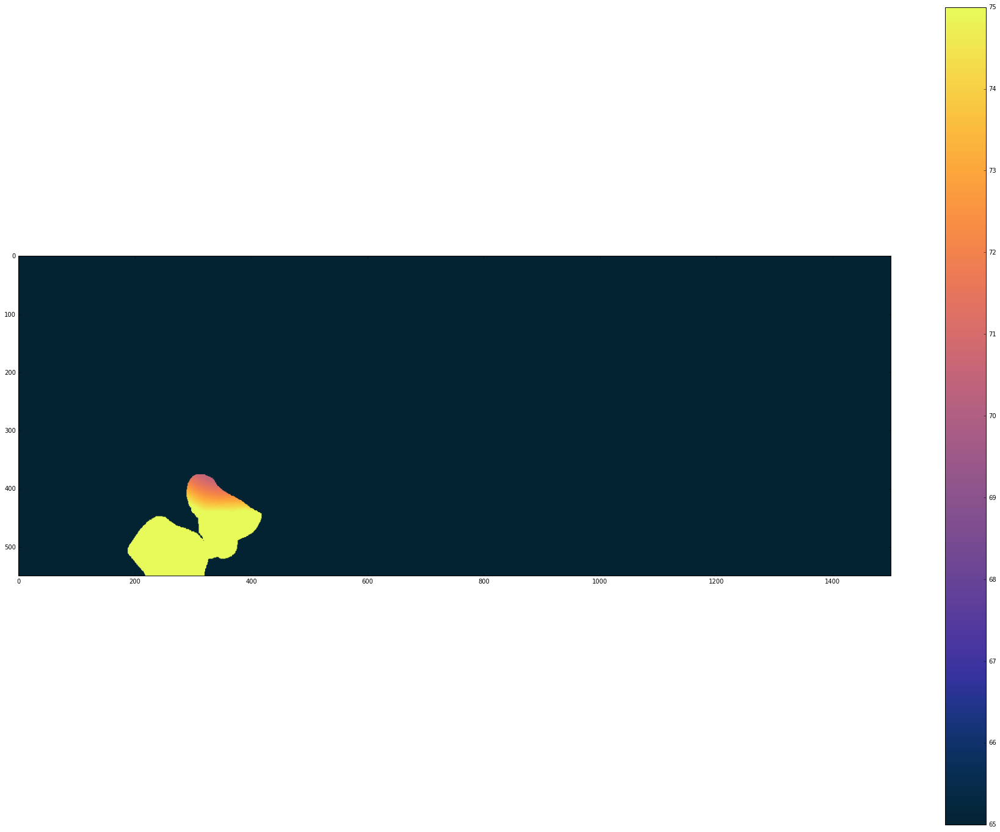

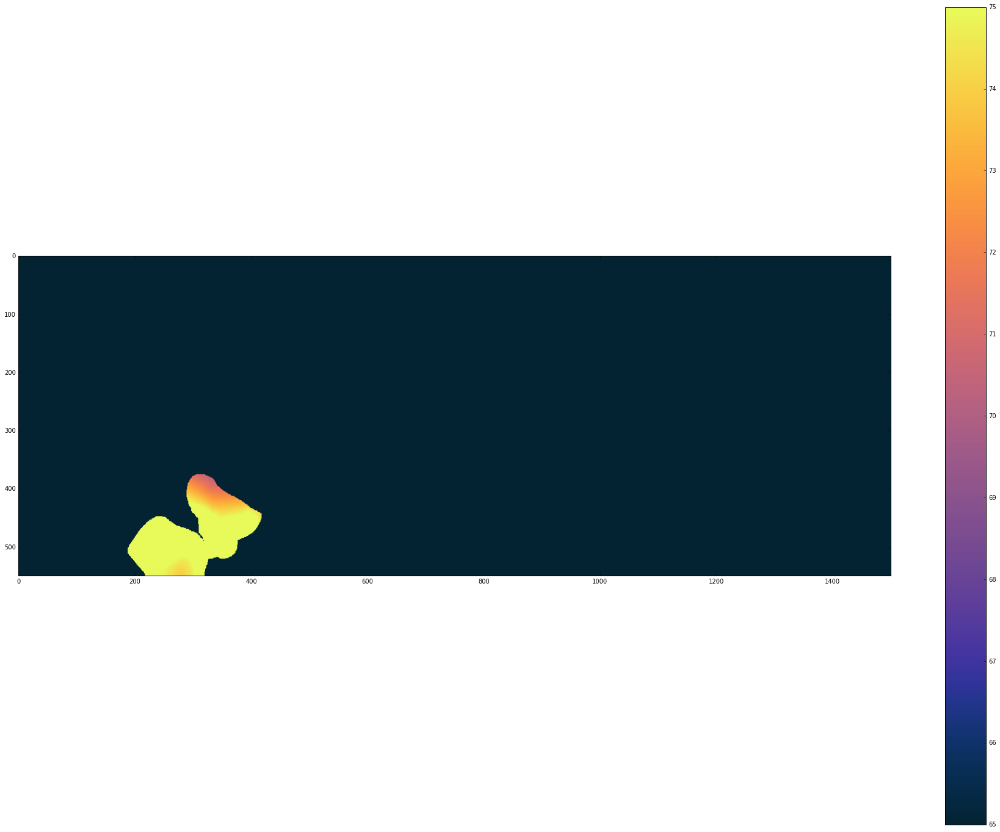

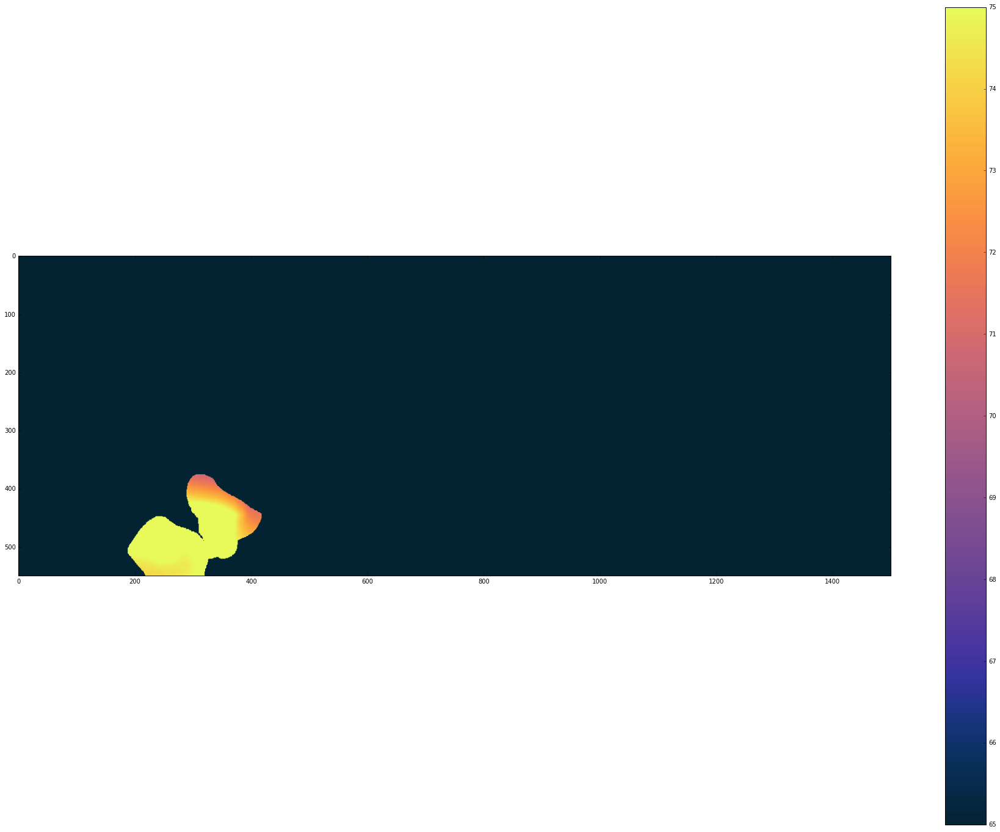

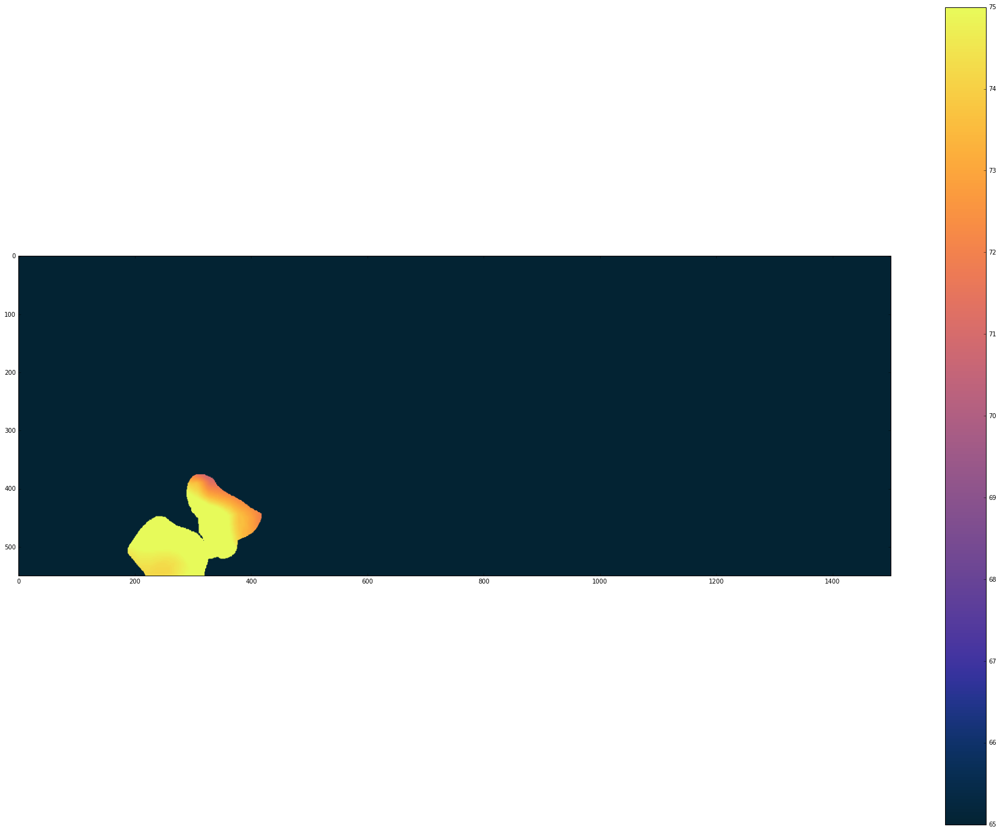

In [ ]:
numbers = len(Temps)

for i in range(0,len(Temps)):
    image = Temps[i] 
    
    # image[image < 70] = 0
    plt.imshow( image.reshape(row,col), cmap = cm.thermal)
    plt.imshow( np.multiply(image,Label_Mask[1]/255).reshape(row,col), cmap = cm.thermal,vmin = 65, vmax = 75)
    plt.colorbar()
    plt.show()

In [ ]:
rest_temp = []

for i in range(0,len(Temps)):
    image = Temps[i] 
    
    mean = np.sum(np.multiply(image,np.invert(np.reshape(th3,(row*col)))//255) )

    rest = np.invert(np.reshape(th3,(row*col)))//255

    mean = mean/np.count_nonzero(rest)

    rest_temp.append(mean)
heat_temp = []

for i in range(0,len(Temps)):
    image = Temps[i] 
    
    mean = np.sum(np.multiply(image, np.reshape(Label_Mask[1],(row*col))//255) )

    rest =  np.reshape(Label_Mask[1],(row*col))//255

    mean = mean/np.count_nonzero(rest)

    heat_temp.append(mean)
    
my_temp = []

for i in range(0,len(Temps)):
    image = Temps[i] 
    
    mean = np.sum(np.multiply(image, np.reshape(Label_Mask[0],(row*col))//255) )

    rest =  np.reshape(Label_Mask[0],(row*col))//255

    mean = mean/np.count_nonzero(rest)

    my_temp.append(mean)
    
    


In [ ]:
plt.plot(rest_temp,  label="Average remaining Temp")
plt.plot(heat_temp, label = "Heater Temperature")
# plt.plot(my_temp, label = "My temperature")
plt.legend(bbox_to_anchor=(1.75, 1.05))

In [ ]:
numbers = len(Temps)

for i in range(0,len(Temps)):
    pic2  = image.reshape(row,col)
    # temp  = cv2.imread(directory + '/' + dir  + '/stitched/stitchedtemps_0.png')

    temps  = np.multiply(image,Label_Mask[1]/255).reshape(row,col)
    f, axarr = plt.subplots(1,2) 
    axarr[0].imshow(pic2[:,1500:3000])
    axarr[1].imshow(temps[:,1500:3000], cmap=cm.thermal ,vmin = 60, vmax = 80)
    # axarr[2].imshow(temp)
   
    count = count + 1
    major_ticks = np.arange(0, 1500, 50)                                              
    minor_ticks = np.arange(0, 600, 50)                                               

    # ax.set_xticks(major_ticks)                                                       
    # ax.set_xticks(minor_ticks, minor=True)                                           
    # ax.set_yticks(minor_ticks)                                                       
    # ax.set_yticks(minor_ticks, minor=True)                                               

    axarr[0].set_xticks(major_ticks)                                                       

    axarr[0].set_yticks(minor_ticks)                                                       


    axarr[0].grid(color='w', linestyle='-', linewidth=2, alpha= 50)    
    axarr[1].set_xticks(major_ticks)                                                       

    axarr[1].set_yticks(minor_ticks)                                                       


    axarr[1].grid(color='w', linestyle='-', linewidth=2, alpha= 50)     
    plt.show() 

# Dunno What

In [ ]:
i = 0
np.max(S_[:,i])
np.min(S_[:,i])

In [ ]:
for i in range(0,n_components):
    plt.imshow(S_[i,:].reshape(row, col), cmap='gray')
    plt.show()
    # plt.imsave('/home/nilavro/data/ICA/2017-12-19/1513685832345/component_'+ str(i) + '.png',S_[i,:].reshape(row, col), cmap='gray')

In [ ]:
from copy import deepcopy
merged =  np.abs(deepcopy(S_[0,:].reshape(row, col)))

for i in range(1,n_components):
    merged = merged + np.abs(deepcopy(S_[i,:].reshape(row, col)))

In [ ]:
plt.imshow(merged, cmap = 'gray')

In [ ]:
import matplotlib
my_cm = matplotlib.cm.get_cmap('gray')

normed_data = (merged - np.min(merged)) / (np.max(merged) - np.min(merged))
mapped_data = my_cm(normed_data)

mapped_data = my_cm(normed_data, bytes=True)
mapped_data = mapped_data[:,:,0]

In [ ]:
ret3,th3 = cv2.threshold(mapped_data,127,255,cv2.THRESH_BINARY)
plt.imshow(th3 , cmap = 'gray')

# Ignore here

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal

from sklearn.decomposition import FastICA, PCA

In [ ]:


# #############################################################################
# Generate sample data
np.random.seed(0)
n_samples = 2000
time = np.linspace(0, 8, n_samples)

s1 = np.sin(2 * time)  # Signal 1 : sinusoidal signal
s2 = np.sign(np.sin(3 * time))  # Signal 2 : square signal
s3 = signal.sawtooth(2 * np.pi * time)  # Signal 3: saw tooth signal

S = np.c_[s1, s2, s3]
S += 0.2 * np.random.normal(size=S.shape)  # Add noise

S /= S.std(axis=0)  # Standardize data
# Mix data
A = np.array([[1, 1, 1], [0.5, 2, 1.0], [1.5, 1.0, 2.0]])  # Mixing matrix
X = np.dot(S, A.T)  # Generate observations



In [ ]:
X.shape

In [ ]:

# Compute ICA
ica = FastICA(n_components=3)
S_ = ica.fit_transform(X)  # Reconstruct signals
A_ = ica.mixing_  # Get estimated mixing matrix

# We can `prove` that the ICA model applies by reverting the unmixing.
assert np.allclose(X, np.dot(S_, A_.T) + ica.mean_)

# For comparison, compute PCA
pca = PCA(n_components=3)
H = pca.fit_transform(X)  # Reconstruct signals based on orthogonal components



In [ ]:
# #############################################################################
# Plot results
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 32, 24 

plt.figure()

models = [X, S, S_, H]
names = ['Observations (mixed signal)',
         'True Sources',
         'ICA recovered signals',
         'PCA recovered signals']
colors = ['red', 'steelblue', 'orange']

for ii, (model, name) in enumerate(zip(models, names), 1):
    plt.subplot(4, 1, ii)
    plt.title(name)
    for sig, color in zip(model.T, colors):
        plt.plot(sig, color=color)

plt.subplots_adjust(0.09, 0.04, 0.94, 0.94, 0.26, 0.46)
plt.show()